In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
%matplotlib inline
pd.options.display.float_format = '{:,.2f}'.format
plt.style.use('seaborn-white')
# colorblind safe
plt.style.use('seaborn-colorblind')
plt.style.use('tableau-colorblind10')

# width and precision for f strings
width = 10
precision = 4

# default sizes for plots
# https://matplotlib.org/3.3.0/tutorials/introductory/customizing.html#customizing-with-matplotlibrc-files
plt.rcParams['figure.figsize'] = [10, 6]
plt.rcParams['font.size'] = 16
plt.rcParams['legend.fontsize'] = 'large'
plt.rcParams['figure.titlesize'] = 'medium'
plt.rcParams['lines.linewidth'] = 2

# other settings
pd.options.display.float_format = '{:,.4f}'.format
pd.set_option("display.precision", 3)
np.set_printoptions(precision=3, suppress=True)
%load_ext autoreload
%autoreload 2
pd.set_option('display.max_columns', None)
%config IPCompleter.greedy=True


In [2]:
# get data
USdata = pd.read_csv('data/iOverlander Places -  2020-08-22.csv')

In [3]:
USdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8790 entries, 0 to 8789
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Location                   1413 non-null   object 
 1   Name                       8790 non-null   object 
 2   Category                   8790 non-null   object 
 3   Description                8790 non-null   object 
 4   Latitude                   8790 non-null   float64
 5   Longitude                  8790 non-null   float64
 6   Altitude                   8567 non-null   float64
 7   Date verified              8790 non-null   object 
 8   Open                       8790 non-null   object 
 9   Electricity                7987 non-null   object 
 10  Wifi                       7987 non-null   object 
 11  Kitchen                    7987 non-null   object 
 12  Parking                    0 non-null      float64
 13  Restaurant                 7987 non-null   objec

In [4]:
USdata.head()

,Location,Name,Category,Description,Latitude,Longitude,Altitude,Date verified,Open,Electricity,Wifi,Kitchen,Parking,Restaurant,Showers,Water,Toilets,Big rig friendly,Tent friendly,Pet friendly,Sanitation dump station,Outdoor gear,Groceries,Artesian goods,Bakery,Rarity in this area,Repairs vehicles,Repairs motorcycles,Repairs bicycles,Sells parts,Recycles batteries,Recycles oil,Bio fuel,Electric vehicle charging,Composting sawdust,Recycling center
0,"Borrego Salton Seaway, Borrego Springs, CA 920...",Anza Borrego - NICE,Wild Camping,Free Camping on Anza Borrego Park. Nice and wa...,33.2806,-116.1469,0.0000,2019-01-28 00:00:00 UTC,Yes,Unknown,Unknown,Unknown,nan,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
1,"Unnamed Road, Austin, NV 89310, USA",Spencer Hotsprings,Wild Camping,Hammer site. Lots of places for vehicle or ten...,39.3306,-116.8546,"1,707.0000",2020-07-03 00:00:00 UTC,Yes,No,No,No,nan,No,No,Natural Source,No,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
2,"Burr Trail Rd, Boulder, UT 84716, USA",Burr Trail - NICE,Wild Camping,Very quiet sleeping places on the Burr Trail t...,37.8702,-111.3375,"1,805.2075",2017-03-25 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,Unknown,Unknown,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
3,"Coral Pink Sand Dunes Rd, Kanab, UT 84741, USA",Coral Pink Sand Dunes - OK,Wild Camping,Free camping without nothing in the BLM area. ...,37.0682,-112.7028,nan,2012-01-01 00:00:00 UTC,Yes,Unknown,Unknown,Unknown,nan,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
4,"Lincoln Highway, Ruth, NV 89319, USA",Ely - OK,Wild Camping,"Cookies at the 50 to Ely. Heard BLM. Fire pit,...",39.3104,-114.9900,"2,079.7598",2019-06-11 18:32:16 UTC,Yes,No,No,No,nan,No,No,No,Unknown,No,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
USdata["Category"].unique()

array(['Wild Camping', 'Informal Campsite', 'Showers', 'Water',
       'Short-term Parking', 'Eco-Friendly'], dtype=object)

In [6]:
USdata['Description'][8700]

'An old Kmart parking lot. Nothing special but q lot kf other vehicles and boats parked there as well. Nktjkng special but pretty quite and good for a quick sleep. '

In [7]:
# get coordinates from one site
lat, long = USdata.loc[0, ['Latitude', 'Longitude']]

In [8]:
lat

33.280572

In [9]:
long

-116.146887

In [21]:
from sentinelsat import SentinelAPI
import getpass
import geopandas as gpd
import folium 
from shapely.geometry import MultiPolygon, Polygon
from pprint import pprint
import rasterio as rio

In [24]:
user = 'detroitstylz'
password = getpass.getpass()
api = SentinelAPI(user, password, 'https://scihub.copernicus.eu/dhus')

········


In [27]:
api

In [25]:
US_states = gpd.read_file('../realty-markets-analyzer/data/tl_2019_us_state/tl_2019_us_state.shp')

m = folium.Map([lat, long], zoom_start=15)
folium.GeoJson(US_states).add_to(m)
m

In [53]:
footprint = None
for i in US_states['geometry']:
    footprint = i

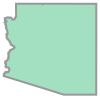

In [54]:
footprint # way too big!!

In [55]:
type(footprint)

shapely.geometry.polygon.Polygon

In [56]:
print(footprint)

POLYGON ((-114.516842 33.027886, -114.516988 33.027987, -114.517894 33.028612, -114.52013 33.029984, -114.523578 33.03096, -114.527555 33.031731, -114.531083 33.032393, -114.538459 33.033422, -114.543131 33.03376, -114.549933 33.033823, -114.553189 33.033974, -114.557597 33.0349, -114.56085 33.035285, -114.5648 33.035077, -114.569196 33.036156, -114.571653 33.036624, -114.575161 33.036541, -114.577449 33.035649, -114.577605 33.035598, -114.578287 33.035375, -114.579054 33.0348, -114.57937 33.034563, -114.581404 33.032545, -114.583029 33.030149, -114.584765 33.02823, -114.585598 33.027747, -114.585793 33.027634, -114.586982 33.026944, -114.588078 33.026663, -114.588203 33.026631, -114.589778 33.026228, -114.594725 33.025848, -114.595886 33.025688, -114.596109 33.025657, -114.598093 33.025384, -114.598825 33.02539, -114.598871 33.025391, -114.601014 33.02541, -114.601228 33.02542, -114.601655 33.025439, -114.601988 33.025457, -114.602117 33.025464, -114.602544 33.025489, -114.602713 33.0

https://scihub.copernicus.eu/twiki/do/view/SciHubUserGuide/FullTextSearch?redirectedfrom=SciHubUserGuide.3FullTextSearch
   
Geographical search of the products whose footprint intersects or is included in a specific geographic type.
Syntax:
footprint:"intersects(<geographic type>)"

The <geographic type> value can be expressed as a polygon or as a point, according to the syntax described below:

GEOGRAPHIC TYPE:

<geographic type>=POLYGON((P1Lon P1Lat, P2Lon P2Lat, …, PnLon PnLat, P1Lon P1Lat))

where P1Lon and P1Lat are the Longitude and Latitude coordinates of the first point of the polygon in decimal degrees (DDD) format (e.g. 2.17403, 41.40338) and so on.
The coordinates of the last point of the polygon must coincide with the coordinates of the first point of the polygon.
There is not a fixed limit for the maximum number of points to be used to define the Area of Interest (AOI). The limit is related to the maximum number of characters for the GUI search (i.e 8000). The maximum footprint extent possible is defined by the Mercator projection used on DHuS, i.e. LAT [-180, + 180] and LONG [-85.05, +85.05].

In [22]:
point = f"POINT (({long}, {lat}))" # long first!
point

'POINT ((-116.146887, 33.280572))'

In [74]:
point = f"{long}, {lat}" # long first!
point

'-116.146887, 33.280572'

In [75]:
products = api.query(point,
                     date = ('20190601', '20190626'),
                     platformname = 'Sentinel-2',
                     processinglevel = 'Level-2A',
                     cloudcoverpercentage = (0,10) 
                    )

# cloudcoverpercentage:[0 TO 5] range 0-100

SentinelAPIError: HTTP status 401 Unauthorized: 
# HTTP Status 401 - Full authentication is required to access this resource

 **type** Status report

 **message** _Full authentication is required to access this resource_

 **description** _This request requires HTTP authentication._

* * *

### Apache Tomcat/8.0.36

In [76]:
type(products)

collections.OrderedDict

In [85]:
len(products)

3

In [98]:
pprint(products)

OrderedDict([('d5e944e0-b2ff-4f47-8421-a9602228ab4e',
              {'beginposition': datetime.datetime(2019, 6, 20, 18, 19, 21, 24000),
               'cloudcoverpercentage': 2.217793,
               'endposition': datetime.datetime(2019, 6, 20, 18, 19, 21, 24000),
               'filename': 'S2A_MSIL2A_20190620T181921_N0212_R127_T11SNS_20190621T001951.SAFE',
               'footprint': 'MULTIPOLYGON (((-115.83214 32.44371364814275, '
                            '-115.819046 33.433952063072354, -117.00021 '
                            '33.43957506752624, -117.00021 32.44912879312563, '
                            '-115.83214 32.44371364814275)))',
               'format': 'SAFE',
               'gmlfootprint': '<gml:Polygon '
                               'srsName="http://www.opengis.net/gml/srs/epsg.xml#4326" '
                               'xmlns:gml="http://www.opengis.net/gml">\n'
                               '   <gml:outerBoundaryIs>\n'
                               '      <

In [100]:
# for k, v in products.items():
#     print(k, v)

d5e944e0-b2ff-4f47-8421-a9602228ab4e {'title': 'S2A_MSIL2A_20190620T181921_N0212_R127_T11SNS_20190621T001951', 'link': "https://scihub.copernicus.eu/dhus/odata/v1/Products('d5e944e0-b2ff-4f47-8421-a9602228ab4e')/$value", 'link_alternative': "https://scihub.copernicus.eu/dhus/odata/v1/Products('d5e944e0-b2ff-4f47-8421-a9602228ab4e')/", 'link_icon': "https://scihub.copernicus.eu/dhus/odata/v1/Products('d5e944e0-b2ff-4f47-8421-a9602228ab4e')/Products('Quicklook')/$value", 'summary': 'Date: 2019-06-20T18:19:21.024Z, Instrument: MSI, Mode: , Satellite: Sentinel-2, Size: 1.11 GB', 'beginposition': datetime.datetime(2019, 6, 20, 18, 19, 21, 24000), 'endposition': datetime.datetime(2019, 6, 20, 18, 19, 21, 24000), 'ingestiondate': datetime.datetime(2019, 6, 21, 6, 44, 24, 439000), 'orbitnumber': 20859, 'relativeorbitnumber': 127, 'cloudcoverpercentage': 2.217793, 'highprobacloudspercentage': 1.177694, 'mediumprobacloudspercentage': 1.039296, 'snowicepercentage': 0.0, 'vegetationpercentage': 17

In [101]:
products_gdf = api.to_geodataframe(products)
products_gdf_sorted = products_gdf.sort_values(['cloudcoverpercentage'], ascending=[True])
products_gdf_sorted

/usr/local/anaconda3/envs/py377/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


,title,link,link_alternative,link_icon,summary,beginposition,endposition,ingestiondate,orbitnumber,relativeorbitnumber,cloudcoverpercentage,highprobacloudspercentage,mediumprobacloudspercentage,snowicepercentage,vegetationpercentage,waterpercentage,notvegetatedpercentage,unclassifiedpercentage,format,instrumentshortname,instrumentname,s2datatakeid,platformidentifier,orbitdirection,platformserialidentifier,processingbaseline,processinglevel,producttype,platformname,size,filename,level1cpdiidentifier,identifier,uuid,geometry
2e9cac96-6f25-4ea5-a5d2-7426ca0893ed,S2B_MSIL2A_20190615T181929_N0212_R127_T11SNS_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2019-06-15T18:19:29.024Z, Instrument: MS...",2019-06-15 18:19:29.024,2019-06-15 18:19:29.024,2019-06-16 02:28:04.130,11879,127,0.4380,0.2667,0.1495,0.0000,19.0504,2.4988,77.6148,0.3432,SAFE,MSI,Multi-Spectral Instrument,GS2B_20190615T181929_011879_N02.12,2017-013A,DESCENDING,Sentinel-2B,02.12,Level-2A,S2MSI2A,Sentinel-2,1.12 GB,S2B_MSIL2A_20190615T181929_N0212_R127_T11SNS_2...,S2B_OPER_MSI_L1C_TL_EPAE_20190615T214850_A0118...,S2B_MSIL2A_20190615T181929_N0212_R127_T11SNS_2...,2e9cac96-6f25-4ea5-a5d2-7426ca0893ed,"MULTIPOLYGON (((-115.83214 32.44371, -115.8190..."
ec5b2d5e-fa08-4de9-b192-b6a74c5e0e16,S2B_MSIL2A_20190605T181929_N0212_R127_T11SNS_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2019-06-05T18:19:29.024Z, Instrument: MS...",2019-06-05 18:19:29.024,2019-06-05 18:19:29.024,2019-06-06 03:55:48.309,11736,127,1.6150,0.8081,0.3795,0.0000,20.2492,2.4982,74.7911,0.4234,SAFE,MSI,Multi-Spectral Instrument,GS2B_20190605T181929_011736_N02.12,2017-013A,DESCENDING,Sentinel-2B,02.12,Level-2A,S2MSI2A,Sentinel-2,1.11 GB,S2B_MSIL2A_20190605T181929_N0212_R127_T11SNS_2...,S2B_OPER_MSI_L1C_TL_SGS__20190605T215915_A0117...,S2B_MSIL2A_20190605T181929_N0212_R127_T11SNS_2...,ec5b2d5e-fa08-4de9-b192-b6a74c5e0e16,"MULTIPOLYGON (((-115.83214 32.44371, -115.8190..."
d5e944e0-b2ff-4f47-8421-a9602228ab4e,S2A_MSIL2A_20190620T181921_N0212_R127_T11SNS_2...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,https://scihub.copernicus.eu/dhus/odata/v1/Pro...,"Date: 2019-06-20T18:19:21.024Z, Instrument: MS...",2019-06-20 18:19:21.024,2019-06-20 18:19:21.024,2019-06-21 06:44:24.439,20859,127,2.2178,1.1777,1.0393,0.0000,17.1797,2.4625,76.8020,1.2040,SAFE,MSI,Multi-Spectral Instrument,GS2A_20190620T181921_020859_N02.12,2015-028A,DESCENDING,Sentinel-2A,02.12,Level-2A,S2MSI2A,Sentinel-2,1.11 GB,S2A_MSIL2A_20190620T181921_N0212_R127_T11SNS_2...,S2A_OPER_MSI_L1C_TL_MPS__20190620T232521_A0208...,S2A_MSIL2A_20190620T181921_N0212_R127_T11SNS_2...,d5e944e0-b2ff-4f47-8421-a9602228ab4e,"MULTIPOLYGON (((-115.83214 32.44371, -115.8190..."


In [102]:
#api.download("2e9cac96-6f25-4ea5-a5d2-7426ca0893ed")

Downloading: 100%|██████████| 1.20G/1.20G [02:28<00:00, 8.11MB/s] 
MD5 checksumming: 100%|██████████| 1.20G/1.20G [00:02<00:00, 453MB/s]


{'id': '2e9cac96-6f25-4ea5-a5d2-7426ca0893ed',
 'title': 'S2B_MSIL2A_20190615T181929_N0212_R127_T11SNS_20190615T222929',
 'size': 1201733526,
 'md5': 'FED28A02250DC4C411B09F370B042D9F',
 'date': datetime.datetime(2019, 6, 15, 18, 19, 29, 24000),
 'footprint': 'POLYGON((-117.00021 33.43957506752624,-115.819046 33.433952063072354,-115.83214 32.44371364814275,-117.00021 32.44912879312563,-117.00021 33.43957506752624))',
 'url': "https://scihub.copernicus.eu/dhus/odata/v1/Products('2e9cac96-6f25-4ea5-a5d2-7426ca0893ed')/$value",
 'Online': True,
 'Creation Date': datetime.datetime(2019, 6, 16, 2, 29, 7, 541000),
 'Ingestion Date': datetime.datetime(2019, 6, 16, 2, 28, 4, 130000),
 'path': './S2B_MSIL2A_20190615T181929_N0212_R127_T11SNS_20190615T222929.zip',
 'downloaded_bytes': 1201733526}

In [105]:
# Open Bands 4, 3 and 2 with Rasterio L2A_T11SNS_A011879_20190615T182424
R10 = 'S2B_MSIL2A_20190615T181929_N0212_R127_T11SNS_20190615T222929.SAFE/GRANULE/L2A_T11SNS_A011879_20190615T182424/IMG_DATA/R10m'
b4 = rio.open(R10+'/T11SNS_20190615T181929_B04_10m.jp2')
b3 = rio.open(R10+'/T11SNS_20190615T181929_B03_10m.jp2')
b2 = rio.open(R10+'/T11SNS_20190615T181929_B02_10m.jp2')

# Create an RGB image 
with rio.open('RGB.tiff','w',driver='Gtiff', width=b4.width, height=b4.height, 
              count=3,crs=b4.crs,transform=b4.transform, dtype=b4.dtypes[0]) as rgb:
    rgb.write(b2.read(1),1) 
    rgb.write(b3.read(1),2) 
    rgb.write(b4.read(1),3) 
    rgb.close()

In [114]:
tif_fn = 'RGB.tiff'

In [115]:
with rio.open(tif_fn) as infile:
    #print(f"\nnew profile: {pprint.pformat(infile.profile)}\n")
    profile=infile.profile
    #
    # change the driver name from GTiff to PNG
    #
    profile['driver']='PNG'
    #
    # pathlib makes it easy to add a new suffix to a
    # filename
    #    
    png_filename = 'RGB.png'
    raster = infile.read()
    with rio.open(png_filename, 'w', **profile) as dst:
        dst.write(raster)

In [60]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

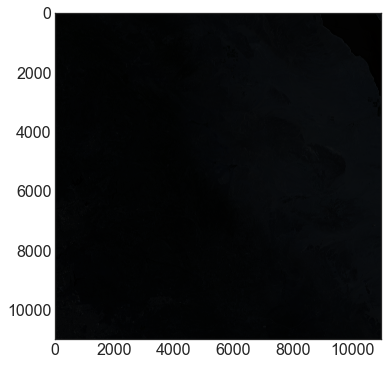

In [118]:
img = mpimg.imread('RGB.png')
plt.imshow(img)
plt.show()

In [1]:
import ee
import datetime

In [2]:
ee.Authenticate()
ee.Initialize()

Enter verification code: 4/3QHrszQr3Y51BIKlRVwqlgEp3HXPDDLrHmt2x6nWFCECqeJfGebP5R8

Successfully saved authorization token.


In [3]:
# test that things work
# Print the elevation of Mount Everest.
dem = ee.Image('USGS/SRTMGL1_003')
xy = ee.Geometry.Point([86.9250, 27.9881]) # long is first!
elev = dem.sample(xy, 30).first().get('elevation').getInfo()
print('Mount Everest elevation (m):', elev)

Mount Everest elevation (m): 8729


In [30]:
landsat = ee.ImageCollection("LANDSAT/LC08/C01/T1_SR")
# setting the Area of Interest (AOI)
# Ituna_AOI = ee.Geometry.Rectangle([-51.84448, -3.92180,
#                                    -52.23999, -4.38201])
# or with a point?
point = ee.Geometry.Point([long, lat])
# filter area
landsat_AOI = landsat.filterBounds(point)
landsat_AOI = landsat_AOI.filterDate('2019-07-01','2019-12-01')

In [73]:
point

ee.Geometry({
  "functionInvocationValue": {
    "functionName": "GeometryConstructors.Point",
    "arguments": {
      "coordinates": {
        "constantValue": [
          -116.146887,
          33.280572
        ]
      }
    }
  }
})

In [33]:
print('Total number:', landsat_AOI.size().getInfo())

Total number: 18


In [34]:
landsat_AOI = landsat_AOI.sort('CLOUD_COVER').first()

In [37]:
print('Cloud Cover (%):', landsat_AOI.get('CLOUD_COVER').getInfo())

Cloud Cover (%): 0


In [38]:
landsat_AOI.getInfo()

{'type': 'Image',
 'bands': [{'id': 'B1',
   'data_type': {'type': 'PixelType',
    'precision': 'int',
    'min': -32768,
    'max': 32767},
   'dimensions': [7611, 7751],
   'crs': 'EPSG:32611',
   'crs_transform': [30, 0, 516285, 0, -30, 3787515]},
  {'id': 'B2',
   'data_type': {'type': 'PixelType',
    'precision': 'int',
    'min': -32768,
    'max': 32767},
   'dimensions': [7611, 7751],
   'crs': 'EPSG:32611',
   'crs_transform': [30, 0, 516285, 0, -30, 3787515]},
  {'id': 'B3',
   'data_type': {'type': 'PixelType',
    'precision': 'int',
    'min': -32768,
    'max': 32767},
   'dimensions': [7611, 7751],
   'crs': 'EPSG:32611',
   'crs_transform': [30, 0, 516285, 0, -30, 3787515]},
  {'id': 'B4',
   'data_type': {'type': 'PixelType',
    'precision': 'int',
    'min': -32768,
    'max': 32767},
   'dimensions': [7611, 7751],
   'crs': 'EPSG:32611',
   'crs_transform': [30, 0, 516285, 0, -30, 3787515]},
  {'id': 'B5',
   'data_type': {'type': 'PixelType',
    'precision': 'in

In [50]:
landsat_AOI_RGB = landsat_AOI.select(['B4', 'B3', 'B2'])

In [51]:
landsat_AOI_RGB.getInfo()

{'type': 'Image',
 'bands': [{'id': 'B4',
   'data_type': {'type': 'PixelType',
    'precision': 'int',
    'min': -32768,
    'max': 32767},
   'dimensions': [7611, 7751],
   'crs': 'EPSG:32611',
   'crs_transform': [30, 0, 516285, 0, -30, 3787515]},
  {'id': 'B3',
   'data_type': {'type': 'PixelType',
    'precision': 'int',
    'min': -32768,
    'max': 32767},
   'dimensions': [7611, 7751],
   'crs': 'EPSG:32611',
   'crs_transform': [30, 0, 516285, 0, -30, 3787515]},
  {'id': 'B2',
   'data_type': {'type': 'PixelType',
    'precision': 'int',
    'min': -32768,
    'max': 32767},
   'dimensions': [7611, 7751],
   'crs': 'EPSG:32611',
   'crs_transform': [30, 0, 516285, 0, -30, 3787515]}],
 'id': 'LANDSAT/LC08/C01/T1_SR/LC08_039037_20190820',
 'version': 1567677625160142,
 'properties': {'IMAGE_QUALITY_TIRS': 9,
  'CLOUD_COVER': 0,
  'EARTH_SUN_DISTANCE': 1.01186,
  'LANDSAT_ID': 'LC08_L1TP_039037_20190820_20190903_01_T1',
  'system:footprint': {'type': 'LinearRing',
   'coordinate

In [57]:
parameters = {'min': 0,
              'max': 1000,
              'dimensions': 512,
              'bands': ['B4', 'B3', 'B2'],
              'region': Ituna_AOI}
landsat_AOI.visualize()

In [77]:
ee.Map.centerObject(landsat_AOI, 11)

AttributeError: module 'ee' has no attribute 'Map'

In [58]:
url = anza.getThumbUrl(parameters)

EEException: Image.visualize: Expected a string or list of strings for field 'bands'.

In [53]:
test = ee.batch.Export.image.toDrive(landsat_AOI_RGB, 'landsat_AOI_RGB_test', scale: 30, region: point)
test.start()
# scale is in meters
# look for this in the tasks here: https://code.earthengine.google.com/#

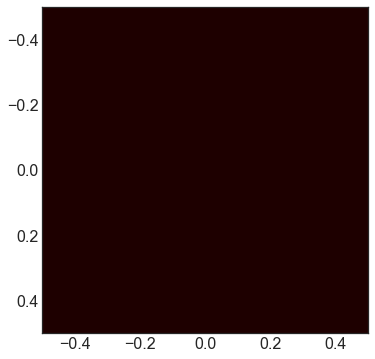

In [67]:
src = rio.open("landsat_AOI_RGB.tif")
plt.imshow(src.read(1), cmap='pink')
plt.show()

TypeError: Invalid shape (3,) for image data

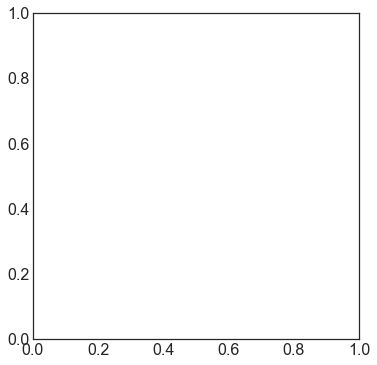

In [72]:
from rasterio.plot import show
#show(src)
show(src.read())

In [ ]:
# other sources to try:
# https://developers.google.com/earth-engine/datasets/catalog/COPERNICUS_S2_SR#description
# USGS
# https://www.usgs.gov/centers/eros/science/usgs-eros-archive-products-overview?qt-science_center_objects=0#qt-science_center_objects
# https://viewer.nationalmap.gov/advanced-viewer/
# https://earthexplorer.usgs.gov/
# https://m2m.cr.usgs.gov/api/docs/json/
# planet
# https://github.com/planetlabs/notebooks/blob/master/jupyter-notebooks/data-api-tutorials/search_and_download_quickstart.ipynb
# https://github.com/planetlabs/notebooks/

In [10]:
import os
G_MAPS_API = os.environ.get("GOOGLE_STATICMAPS_API")

In [11]:
# or with this package?
# https://github.com/googlemaps/google-maps-services-python
import googlemaps

In [12]:
googlemaps.__version__

'4.4.2'

In [13]:
gmaps = googlemaps.Client(G_MAPS_API)
# https://googlemaps.github.io/google-maps-services-python/docs/index.html
# some awesome methods:
# elevation(*args, **kwargs)
# nearest_roads(*args, **kwargs)¶

In [14]:
gmaps

In [38]:
# static_map(gmaps, size,
#                center=None, zoom=None, scale=None, 
#                format=None, maptype=None, language=None, region=None,
#                markers=None, path=None, visible=None, style=None)

#from googlemaps import convert
#from googlemaps import static_map

testmap = gmaps.static_map(size = (400, 400), # pixels
           zoom = 19, # 1-21
           center = (lat, long),
           scale = 1, # default is 1, 2 returns 2x pixels for high res displays
           maptype = "satellite",
           format = "png",
           #visible=["Tok,AK"]
          )

In [31]:
testmap

<generator object Response.iter_content.<locals>.generate at 0x7ffb62224d50>

In [ ]:
# so this is: iterator containing the raw image data, which typically can be used to save an image file locally

In [ ]:
dir(testmap)

In [39]:
fn = 'testmap19.png'

In [40]:
f = open(fn, 'wb')
for chunk in testmap:
    if chunk:
        f.write(chunk)
f.close()

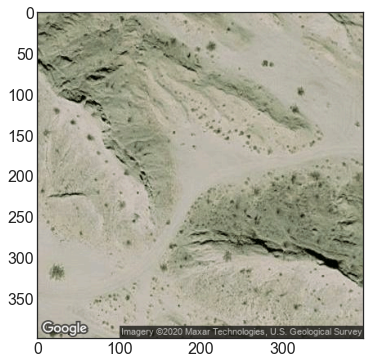

In [41]:
img = plt.imread(fn)
plt.imshow(img)
plt.show()

In [42]:
# maybe start with CO sites
USdata.head()

,Location,Name,Category,Description,Latitude,Longitude,Altitude,Date verified,Open,Electricity,Wifi,Kitchen,Parking,Restaurant,Showers,Water,Toilets,Big rig friendly,Tent friendly,Pet friendly,Sanitation dump station,Outdoor gear,Groceries,Artesian goods,Bakery,Rarity in this area,Repairs vehicles,Repairs motorcycles,Repairs bicycles,Sells parts,Recycles batteries,Recycles oil,Bio fuel,Electric vehicle charging,Composting sawdust,Recycling center
0,"Borrego Salton Seaway, Borrego Springs, CA 920...",Anza Borrego - NICE,Wild Camping,Free Camping on Anza Borrego Park. Nice and wa...,33.2806,-116.1469,0.0000,2019-01-28 00:00:00 UTC,Yes,Unknown,Unknown,Unknown,nan,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
1,"Unnamed Road, Austin, NV 89310, USA",Spencer Hotsprings,Wild Camping,Hammer site. Lots of places for vehicle or ten...,39.3306,-116.8546,"1,707.0000",2020-07-03 00:00:00 UTC,Yes,No,No,No,nan,No,No,Natural Source,No,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
2,"Burr Trail Rd, Boulder, UT 84716, USA",Burr Trail - NICE,Wild Camping,Very quiet sleeping places on the Burr Trail t...,37.8702,-111.3375,"1,805.2075",2017-03-25 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,Unknown,Unknown,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
3,"Coral Pink Sand Dunes Rd, Kanab, UT 84741, USA",Coral Pink Sand Dunes - OK,Wild Camping,Free camping without nothing in the BLM area. ...,37.0682,-112.7028,nan,2012-01-01 00:00:00 UTC,Yes,Unknown,Unknown,Unknown,nan,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
4,"Lincoln Highway, Ruth, NV 89319, USA",Ely - OK,Wild Camping,"Cookies at the 50 to Ely. Heard BLM. Fire pit,...",39.3104,-114.9900,"2,079.7598",2019-06-11 18:32:16 UTC,Yes,No,No,No,nan,No,No,No,Unknown,No,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN


In [43]:
USdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8790 entries, 0 to 8789
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Location                   1413 non-null   object 
 1   Name                       8790 non-null   object 
 2   Category                   8790 non-null   object 
 3   Description                8790 non-null   object 
 4   Latitude                   8790 non-null   float64
 5   Longitude                  8790 non-null   float64
 6   Altitude                   8567 non-null   float64
 7   Date verified              8790 non-null   object 
 8   Open                       8790 non-null   object 
 9   Electricity                7987 non-null   object 
 10  Wifi                       7987 non-null   object 
 11  Kitchen                    7987 non-null   object 
 12  Parking                    0 non-null      float64
 13  Restaurant                 7987 non-null   objec

In [46]:
# we don't have state col.. can do reverse geocode lookup
USdata.loc[USdata['Location'].isnull(),]

,Location,Name,Category,Description,Latitude,Longitude,Altitude,Date verified,Open,Electricity,Wifi,Kitchen,Parking,Restaurant,Showers,Water,Toilets,Big rig friendly,Tent friendly,Pet friendly,Sanitation dump station,Outdoor gear,Groceries,Artesian goods,Bakery,Rarity in this area,Repairs vehicles,Repairs motorcycles,Repairs bicycles,Sells parts,Recycles batteries,Recycles oil,Bio fuel,Electric vehicle charging,Composting sawdust,Recycling center
1221,NaN,Springer Lake,Wild Camping,Dispersed camping on shore of small lake. Ceme...,36.4088,-104.6526,"1,788.0000",2020-04-01 00:00:00 UTC,Yes,No,No,No,nan,No,No,Natural Source,Pit Toilets,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
1222,NaN,"large flat spot - on route 9 , before the 89 j...",Wild Camping,Be careful low branches. Not suitable for rvs...,37.2615,-112.7791,"1,811.0000",2019-05-29 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
1223,NaN,Zigzag falls,Wild Camping,Lots of small camping spots along Kiwanis Camp...,45.3141,-121.8082,944.3531,2019-06-02 00:00:00 UTC,Yes,No,No,No,nan,No,No,Natural Source,No,No,Yes,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
1224,NaN,Topsy Grade Rd,Wild Camping,Open woodlands along the reservoir with plenty...,42.1318,-122.0332,"1,194.4113",2019-09-27 00:00:00 UTC,Yes,No,No,No,nan,No,No,Non-Potable,No,No,Yes,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
1225,NaN,Lava tubes,Wild Camping,Pit toilet picnic table site,34.9446,-108.1069,"2,324.8057",2017-09-24 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,Pit Toilets,Unknown,Unknown,Unknown,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8785,NaN,A Road Runs Through It,Wild Camping,Nice large space big enough for a few small ri...,46.9263,-114.7089,976.8579,2020-08-22 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
8786,NaN,Ross Cedar Creek sites,Wild Camping,There are three sites off the side of the road...,48.2083,-115.8590,706.9746,2020-08-22 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,No,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
8787,NaN,Bur Oak Brewery,Informal Campsite,driving West on I-70 I was looking for a place...,38.9549,-92.2109,220.9904,2020-08-20 00:00:00 UTC,Yes,No,Unknown,No,nan,No,No,No,No,Yes,No,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
8788,NaN,Montezuma Rd,Wild Camping,Beautiful vista about 200' up from (St. John's...,39.5548,-105.8640,"3,292.9993",2020-08-22 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,No,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# https://developer.mapquest.com/documentation/geocoding-api/batch/get/

In [49]:
latlong = '36.4088,-104.6526'
latlong 

'36.4088,-104.6526'

In [53]:
# try with one: 
res_type = 'administrative_area_level_1|postal_code'
result = gmaps.reverse_geocode(latlong, result_type=res_type)

In [55]:
len(result)

2

In [56]:
from pprint import pprint

In [57]:
pprint(result)

[{'address_components': [{'long_name': '87747',
                          'short_name': '87747',
                          'types': ['postal_code']},
                         {'long_name': 'Springer',
                          'short_name': 'Springer',
                          'types': ['locality', 'political']},
                         {'long_name': 'Colfax County',
                          'short_name': 'Colfax County',
                          'types': ['administrative_area_level_2',
                                    'political']},
                         {'long_name': 'New Mexico',
                          'short_name': 'NM',
                          'types': ['administrative_area_level_1',
                                    'political']},
                         {'long_name': 'United States',
                          'short_name': 'US',
                          'types': ['country', 'political']}],
  'formatted_address': 'Springer, NM 87747, USA',
  'geometry': {'bound

In [70]:
# cool let's wait before we do that for all of them.. also need less than 50 requests per sec for API
USdata_CO = USdata.dropna(subset=['Location'], axis=0).reset_index()
USdata_CO = USdata_CO[USdata_CO['Location'].str.contains(' CO', case=True, regex=False)]

In [71]:
USdata_CO.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110 entries, 13 to 1366
Data columns (total 37 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   index                      110 non-null    int64  
 1   Location                   110 non-null    object 
 2   Name                       110 non-null    object 
 3   Category                   110 non-null    object 
 4   Description                110 non-null    object 
 5   Latitude                   110 non-null    float64
 6   Longitude                  110 non-null    float64
 7   Altitude                   108 non-null    float64
 8   Date verified              110 non-null    object 
 9   Open                       110 non-null    object 
 10  Electricity                109 non-null    object 
 11  Wifi                       109 non-null    object 
 12  Kitchen                    109 non-null    object 
 13  Parking                    0 non-null      float

In [72]:
USdata_CO.head()

,index,Location,Name,Category,Description,Latitude,Longitude,Altitude,Date verified,Open,Electricity,Wifi,Kitchen,Parking,Restaurant,Showers,Water,Toilets,Big rig friendly,Tent friendly,Pet friendly,Sanitation dump station,Outdoor gear,Groceries,Artesian goods,Bakery,Rarity in this area,Repairs vehicles,Repairs motorcycles,Repairs bicycles,Sells parts,Recycles batteries,Recycles oil,Bio fuel,Electric vehicle charging,Composting sawdust,Recycling center
13,13,"San Juan National Forest, Usfs 622, Bayfield, ...",National Forest Outside Durango,Wild Camping,Free. Great quiet camping in canyon next to r...,37.3555,-107.3236,"2,221.0000",2014-06-16 10:07:52 UTC,Yes,No,No,No,nan,No,No,Natural Source,Pit Toilets,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
14,14,"United States Forest Grand Mesa, 8001-8227 Co ...",National Forest outside Ouray,Wild Camping,Beautiful mountain scenery along this 40 mile ...,38.2037,-107.5117,"2,765.0000",2014-06-19 08:17:02 UTC,Yes,No,No,No,nan,No,No,Natural Source,No,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
16,16,"330 East Road, Silt, CO 81652, USA",National Forest outside Glenwood Springs,Wild Camping,Free. National Forest camping off a dirt road...,39.3312,-107.6682,"2,437.0000",2019-09-26 16:45:26 UTC,Yes,No,No,No,nan,No,No,No,No,No,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
17,17,"Co Rd 67, Maybell, CO 81640, USA",Wild Horse Area,Wild Camping,Free camping in the middle of the Sand Wash Wi...,40.6797,-108.3990,"1,862.0000",2018-12-03 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,Yes,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
101,101,"33993 US-160, Mancos, CO 81328, USA",Mesa verde Nationalpark (outside In BLM),Wild Camping,Close to the entrence of mesa verde nationalpa...,37.3595,-108.4228,"2,054.2000",2020-07-20 00:00:00 UTC,Yes,No,No,No,nan,No,No,No,No,No,Yes,Yes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN
